**Table of contents**<a id='toc0_'></a>    
- [EDA by Column Category](#toc1_1_)    
  - [Category 1: In-fight Data](#toc1_2_)    
    - [A. Check for Missing Values](#toc1_2_1_)    
    - [B. Check Distributions for Normality](#toc1_2_2_)    
    - [C. Check Correlations with Target Variable](#toc1_2_3_)    
  - [Category 2: Rolling Metrics](#toc1_3_)    
    - [A. Check for Missing Values](#toc1_3_1_)    
    - [B. Check Distributions for Normality](#toc1_3_2_)    
    - [C. Check Correlations with Target Variable](#toc1_3_3_)    
    - [D. Check boxplot distributions by target variable](#toc1_3_4_)    
  - [Category 3: Rolling Differentials](#toc1_4_)    
    - [A. Check for Missing Values](#toc1_4_1_)    
    - [B. Check Distributions for Normality](#toc1_4_2_)    
    - [    C. Check Correlations with Target Variable](#toc1_4_3_)    
    - [D. Check boxplot distributions by target variable](#toc1_4_4_)    
    - [E. Correlation Boxplot](#toc1_4_5_)    
  - [Category 4: Fighter Histories](#toc1_5_)    
    - [A. Check for Missing Values](#toc1_5_1_)    
    - [B. Check Distributions for Normality](#toc1_5_2_)    
    - [C. Check Correlations with Target Variable](#toc1_5_3_)    
  - [Highest Correlations by Weightclass](#toc1_6_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

Here, we need to:
- [ ] Check for missing values
- [ ] Check Distributions for normality
- [ ] Check for outliers
- [ ] Check for correlations


In [35]:
# Load Packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.ticker as mtick
import seaborn as sns
from matplotlib.pyplot import figure
from bs4 import BeautifulSoup
import time
import requests     
import shutil      
import datetime
from scipy.stats import norm
from random import randint
import  random
import os
os.chdir('C:/Users/Travis/OneDrive/Data Science/Personal_Projects/Sports/UFC_Prediction_V2')
from bs4 import BeautifulSoup 
import seaborn as sns
from scipy.stats import norm
import warnings
warnings.filterwarnings('ignore')
import requests
import json
from random import randint
import  random
import os
from cmath import nan
from bs4 import BeautifulSoup
from sklearn.pipeline import Pipeline, make_pipeline, FeatureUnion
import pickle
from sklearn.metrics import fbeta_score
import winsound
from bs4 import BeautifulSoup
import time
import plotly.express as px
from statsmodels.stats.weightstats import ztest
from scipy.stats import gaussian_kde


In [36]:
# load
df  = pd.read_csv('data/final/aggregates/Double_Fights_DF_V16.csv') 
df.head(3)

,Unnamed: 0,Fighter_A,Fighter_B,A_Kd,B_Kd,A_Sig_strike_land,A_Sig_strike_att,B_Sig_strike_land,B_Sig_strike_att,A_Sig_strike_percent,...,B_Martial_Art_Year_Started_2,A_Martial_Art_3,B_Martial_Art_3,A_Martial_Art_Instructor_3,B_Martial_Art_Instructor_3,A_Martial_Art_Year_Started_3,B_Martial_Art_Year_Started_3,A_Style,B_Style,Style_Matchup
0,0,Holly Holm,Irene Aldana,0,0,154,301,69,185,0.51,...,2009.0,Muay Thai,Brazilian Jiu-Jitsu,Mike Winkeljohn,Instructor: Gustavo Dantas,2001.0,2012.0,Boxing,Boxing,Boxing vs Boxing
1,1,Greg Hardy,Ben Sosoli,0,0,54,105,26,97,0.51,...,2012.0,Boxing,Boxing,Din Thomas,John Wayne Parr,2012.0,2013.0,Wrestling,Boxing,Wrestling vs Boxing
2,2,Jared Rosholt,Josh Copeland,0,0,22,45,9,36,0.48,...,2013.0,Brazilian Jiu-Jitsu,Brazilian Jiu-Jitsu,Professor Jason Tooke,Carlos Gracie Jr.,2007.0,2016.0,Wrestling,Brazilian Jiu-Jitsu,Wrestling vs Brazilian Jiu-Jitsu


In [37]:
# replace and INF with 0
df.replace([np.inf, -np.inf], 0, inplace=True)

In [38]:
df.describe()

,Unnamed: 0,A_Kd,B_Kd,A_Sig_strike_land,A_Sig_strike_att,B_Sig_strike_land,B_Sig_strike_att,A_Sig_strike_percent,B_Sig_strike_percent,A_Total_Strikes_land,...,Dif_Opp_Avg_Clinch_Strikes_land_per_round,Dif_Opp_Avg_Clinch_Strikes_att_per_round,Dif_Opp_Avg_Ground_Strikes_land_per_round,Dif_Opp_Avg_Ground_Strikes_att_per_round,A_Martial_Art_Year_Started_1,B_Martial_Art_Year_Started_1,A_Martial_Art_Year_Started_2,B_Martial_Art_Year_Started_2,A_Martial_Art_Year_Started_3,B_Martial_Art_Year_Started_3
count,8342.000000,8342.000000,8342.000000,8342.000000,8342.000000,8342.000000,8342.000000,8342.000000,8342.000000,8342.000000,...,7606.000000,7.638000e+03,7.558000e+03,7.574000e+03,7771.000000,7771.000000,8292.000000,8292.000000,8292.000000,8292.000000
mean,4490.941501,0.223448,0.223448,38.074443,86.370175,38.074443,86.370175,0.449228,0.449228,55.432990,...,0.000000,-1.860547e-18,-3.008384e-17,-1.876268e-17,2002.085060,2002.085060,2004.588519,2004.588519,2006.307767,2006.307767
std,2583.822029,0.501466,0.501466,31.800875,69.727461,31.800875,69.727461,0.160983,0.160983,43.259582,...,7.956514,1.111334e+01,8.789182e+00,1.213282e+01,10.768315,10.768315,9.911562,9.911562,9.481775,9.481775
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-247.076923,-3.153077e+02,-2.052333e+02,-3.010000e+02,1590.000000,1590.000000,1620.000000,1620.000000,1630.000000,1630.000000
25%,2254.250000,0.000000,0.000000,14.000000,32.000000,14.000000,32.000000,0.350000,0.350000,21.000000,...,-0.222551,-3.088526e-01,-2.180490e-01,-2.992165e-01,1999.000000,1999.000000,2001.000000,2001.000000,2003.000000,2003.000000
50%,4475.500000,0.000000,0.000000,31.000000,71.000000,31.000000,71.000000,0.450000,0.450000,48.000000,...,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,2003.000000,2003.000000,2006.000000,2006.000000,2007.000000,2007.000000
75%,6729.750000,0.000000,0.000000,54.000000,124.000000,54.000000,124.000000,0.550000,0.550000,79.000000,...,0.222551,3.088526e-01,2.180490e-01,2.992165e-01,2007.000000,2007.000000,2009.000000,2009.000000,2011.000000,2011.000000
max,8951.000000,5.000000,5.000000,445.000000,744.000000,445.000000,744.000000,1.000000,1.000000,447.000000,...,247.076923,3.153077e+02,2.052333e+02,3.010000e+02,2018.000000,2018.000000,2019.000000,2019.000000,2020.000000,2020.000000


View Columns and Missing Values

In [39]:
cols = df.columns.to_list()
len(cols)

825

There are 825 columns in the dataset. Let's organize the columns by category to see what we're working with.


In [40]:
columns_by_category = {
    'In_Fight_Metrics': [
        'A_Kd', 'B_Kd', 'A_Sig_strike_land', 'A_Sig_strike_att', 'B_Sig_strike_land', 'B_Sig_strike_att', 
        'A_Sig_strike_percent', 'B_Sig_strike_percent', 'A_Total_Strikes_land', 'A_Total_Strikes_att', 
        'B_Total_Strikes_land', 'B_Total_Strikes_att', 'A_Total_Strikes_percent', 'B_Total_Strikes_percent', 
        'A_Takedowns_land', 'A_Takedowns_att', 'B_Takedowns_land', 'B_Takedowns_att', 'A_Takedown_percent', 
        'B_Takedown_percent', 'A_Sub_Attempts_land', 'A_Sub_Attempts_att', 'B_Sub_Attempts_land', 
        'B_Sub_Attempts_att', 'A_Rev', 'B_Rev', 'A_Ctrl_time_min', 'A_Ctrl_time_sec', 'B_Ctrl_time_min', 
        'B_Ctrl_time_sec', 'A_Ctrl_time_tot', 'B_Ctrl_time_tot', 'details', 'event_title', 'event_url', 
        'date', 'Winner', 'fight_id', 'A_Head_Strikes_land', 'A_Head_Strikes_att', 'B_Head_Strikes_land', 
        'B_Head_Strikes_att', 'A_Head_Strikes_percent', 'B_Head_Strikes_percent', 'A_Body_Strikes_land', 
        'A_Body_Strikes_att', 'B_Body_Strikes_land', 'B_Body_Strikes_att', 'A_Body_Strikes_percent', 
        'B_Body_Strikes_percent', 'A_Leg_Strikes_land', 'A_Leg_Strikes_att', 'B_Leg_Strikes_land', 
        'B_Leg_Strikes_att', 'A_Leg_Strikes_percent', 'B_Leg_Strikes_percent', 'A_Distance_Strikes_land', 
        'A_Distance_Strikes_att', 'B_Distance_Strikes_land', 'B_Distance_Strikes_att', 
        'A_Distance_Strikes_percent', 'B_Distance_Strikes_percent', 'A_Clinch_Strikes_land', 
        'A_Clinch_Strikes_att', 'B_Clinch_Strikes_land', 'B_Clinch_Strikes_att', 'A_Clinch_Strikes_percent', 
        'B_Clinch_Strikes_percent', 'A_Ground_Strikes_land', 'A_Ground_Strikes_att', 'B_Ground_Strikes_land', 
        'B_Ground_Strikes_att', 'A_Ground_Strikes_percent', 'B_Ground_Strikes_percent', 'Dif_Kd', 
        'Dif_Sig_strike_land', 'Dif_Sig_strike_att', 'Dif_Sig_strike_percent', 'Dif_Total_Strikes_land', 
        'Dif_Total_Strikes_att', 'Dif_Total_Strikes_percent', 'Dif_Takedowns_land', 'Dif_Takedowns_att', 
        'Dif_Takedown_percent', 'Dif_Sub_Attempts_land', 'Dif_Sub_Attempts_att', 'Dif_Rev', 
        'Dif_Ctrl_time_min', 'Dif_Ctrl_time_sec', 'Dif_Ctrl_time_tot', 'Dif_Head_Strikes_land', 
        'Dif_Head_Strikes_att', 'Dif_Head_Strikes_percent','Dif_Body_Strikes_land', 
        'Dif_Body_Strikes_att', 'Dif_Body_Strikes_percent', 'Dif_Leg_Strikes_land', 
        'Dif_Leg_Strikes_att', 'Dif_Leg_Strikes_percent', 'Dif_Distance_Strikes_land', 'Dif_Distance_Strikes_att', 
        'Dif_Distance_Strikes_percent', 'Dif_Clinch_Strikes_land', 'Dif_Clinch_Strikes_att', 
        'Dif_Clinch_Strikes_percent', 'Dif_Ground_Strikes_land', 'Dif_Ground_Strikes_att', 
        'Dif_Ground_Strikes_percent', 'InFightData__Method_Primary', 'InFightData__Method_Detail', 
        'InFightData__Round', 'InFightData__Time', 'A_Sub_Success_Percent', 'B_Sub_Success_Percent', 'Dif_Sub_Success_Percent'
    ],
    'Previous_Opponent_Metrics': [
        'A_Opp_Avg_Head_Strikes_percent', 'B_Opp_Avg_Head_Strikes_percent', 'A_Opp_Avg_Body_Strikes_land', 
        'B_Opp_Avg_Body_Strikes_land', 'A_Opp_Avg_Body_Strikes_att', 'B_Opp_Avg_Body_Strikes_att', 
        'A_Opp_Avg_Body_Strikes_percent', 'B_Opp_Avg_Body_Strikes_percent', 'A_Opp_Avg_Leg_Strikes_land', 
        'B_Opp_Avg_Leg_Strikes_land', 'A_Opp_Avg_Leg_Strikes_att', 'B_Opp_Avg_Leg_Strikes_att', 
        'A_Opp_Avg_Leg_Strikes_percent', 'B_Opp_Avg_Leg_Strikes_percent', 'A_Opp_Avg_Distance_Strikes_land', 
        'B_Opp_Avg_Distance_Strikes_land', 'A_Opp_Avg_Distance_Strikes_att', 'B_Opp_Avg_Distance_Strikes_att', 
        'A_Opp_Avg_Distance_Strikes_percent', 'B_Opp_Avg_Distance_Strikes_percent', 'A_Opp_Avg_Clinch_Strikes_land', 
        'B_Opp_Avg_Clinch_Strikes_land', 'A_Opp_Avg_Clinch_Strikes_att', 'B_Opp_Avg_Clinch_Strikes_att', 
        'A_Opp_Avg_Clinch_Strikes_percent', 'B_Opp_Avg_Clinch_Strikes_percent', 'A_Opp_Avg_Ground_Strikes_land', 
        'B_Opp_Avg_Ground_Strikes_land', 'A_Opp_Avg_Ground_Strikes_att', 'B_Opp_Avg_Ground_Strikes_att', 
        'A_Opp_Avg_Ground_Strikes_percent', 'B_Opp_Avg_Ground_Strikes_percent', 'A_Opp_Avg_Kd', 'B_Opp_Avg_Kd', 
        'A_Opp_Avg_Sig_strike_land', 'B_Opp_Avg_Sig_strike_land', 'A_Opp_Avg_Sig_strike_att', 
        'A_Opp_Avg_Total_Strikes_percent', 'B_Opp_Avg_Total_Strikes_percent', 'A_Opp_Avg_Takedowns_land', 
        'B_Opp_Avg_Takedowns_land', 'A_Opp_Avg_Takedowns_att', 'B_Opp_Avg_Takedowns_att', 
        'A_Opp_Avg_Takedown_percent', 'B_Opp_Avg_Takedown_percent', 'A_Opp_Avg_Sub_Attempts_land', 
        'B_Opp_Avg_Sub_Attempts_land', 'A_Opp_Avg_Sub_Attempts_att', 
        'B_Opp_Avg_Sub_Attempts_att', 'A_Opp_Avg_Rev', 'B_Opp_Avg_Rev', 'A_Opp_Avg_Ctrl_time_min', 
        'B_Opp_Avg_Ctrl_time_min', 'A_Opp_Avg_Ctrl_time_sec', 'B_Opp_Avg_Ctrl_time_sec', 'A_Opp_Avg_Ctrl_time_tot', 
        'B_Opp_Avg_Ctrl_time_tot', 'A_Opp_Avg_Head_Strikes_land', 'B_Opp_Avg_Head_Strikes_land', 
        'A_Opp_Avg_Head_Strikes_att', 'B_Opp_Avg_Head_Strikes_att', 'B_Opp_Avg_Sig_strike_att', 
        'A_Opp_Avg_Sig_strike_percent', 'B_Opp_Avg_Sig_strike_percent', 'A_Opp_Avg_Total_Strikes_land', 
        'B_Opp_Avg_Total_Strikes_land', 'A_Opp_Avg_Total_Strikes_att', 'B_Opp_Avg_Total_Strikes_att'
    ],
    'Previous_Opponent_Per_Round': [
        'A_Opp_Avg_Body_Strikes_land_per_round', 'A_Opp_Avg_Body_Strikes_att_per_round', 'A_Opp_Avg_Leg_Strikes_land_per_round',
        'A_Opp_Avg_Leg_Strikes_att_per_round', 'A_Opp_Avg_Distance_Strikes_land_per_round', 'A_Opp_Avg_Distance_Strikes_att_per_round',
        'A_Opp_Avg_Clinch_Strikes_land_per_round', 'A_Opp_Avg_Clinch_Strikes_att_per_round', 'A_Opp_Avg_Ground_Strikes_land_per_round',
        'A_Opp_Avg_Ground_Strikes_att_per_round', 'A_Opp_Avg_Kd_per_round', 'A_Opp_Avg_Sig_strike_land_per_round',
        'A_Opp_Avg_Sig_strike_att_per_round', 'A_Opp_Avg_Takedowns_land_per_round', 'A_Opp_Avg_Takedowns_att_per_round',
        'A_Opp_Avg_Sub_Attempts_land_per_round', 'A_Opp_Avg_Sub_Attempts_att_per_round', 'A_Opp_Avg_Rev_per_round',
        'A_Opp_Avg_Ctrl_time_min_per_round', 'A_Opp_Avg_Ctrl_time_sec_per_round', 'A_Opp_Avg_Ctrl_time_tot_per_round',
        'A_Opp_Avg_Head_Strikes_land_per_round', 'A_Opp_Avg_Head_Strikes_att_per_round', 'A_Opp_Avg_Total_Strikes_land_per_round',
        'A_Opp_Avg_Total_Strikes_att_per_round', 'B_Opp_Avg_Body_Strikes_land_per_round', 'B_Opp_Avg_Body_Strikes_att_per_round',
        'B_Opp_Avg_Leg_Strikes_land_per_round', 'B_Opp_Avg_Leg_Strikes_att_per_round', 'B_Opp_Avg_Distance_Strikes_land_per_round',
        'B_Opp_Avg_Distance_Strikes_att_per_round', 'B_Opp_Avg_Clinch_Strikes_land_per_round', 'B_Opp_Avg_Clinch_Strikes_att_per_round',
        'B_Opp_Avg_Ground_Strikes_land_per_round', 'B_Opp_Avg_Ground_Strikes_att_per_round', 'B_Opp_Avg_Kd_per_round',
        'B_Opp_Avg_Sig_strike_land_per_round', 'B_Opp_Avg_Takedowns_land_per_round', 'B_Opp_Avg_Takedowns_att_per_round',
        'B_Opp_Avg_Sub_Attempts_land_per_round', 'B_Opp_Avg_Sub_Attempts_att_per_round', 'B_Opp_Avg_Rev_per_round',
        'B_Opp_Avg_Ctrl_time_min_per_round', 'B_Opp_Avg_Ctrl_time_sec_per_round', 'B_Opp_Avg_Ctrl_time_tot_per_round',
        'B_Opp_Avg_Head_Strikes_land_per_round', 'B_Opp_Avg_Head_Strikes_att_per_round', 'B_Opp_Avg_Sig_strike_att_per_round',
        'B_Opp_Avg_Total_Strikes_land_per_round', 'B_Opp_Avg_Total_Strikes_att_per_round', 'A_Opp_Avg_Sub_Success_Percent_per_round',
        'B_Opp_Avg_Sub_Success_Percent_per_round'
    ],
    'Size_Metrics':[
        'A_Height', 'B_Height', 'Dif_Height',
        'A_Reach', 'B_Reach', 'Dif_Reach',
        'A_Leg_Reach', 'B_Leg_Reach', 'Dif_Leg_Reach',
        'A_Reach_NA', 'B_Reach_NA', 'Reach_NA',
        'A_Leg_Reach_NA', 'B_Leg_Reach_NA', 'Leg_Reach_NA',
        'A_Typical_Weightclass', 'B_Typical_Weightclass', 'fight_weightclass',
        'A_Fight_in_Typical_Weightclass', 'B_Fight_in_Typical_Weightclass', 'A_Ape_Index',
        'B_Ape_Index', 'A_Leg_Index', 'B_Leg_Index',
        'A_Leg_to_Wing_Index', 'B_Leg_to_Wing_Index'
    ],
    'Odds_Metrics':[
        'Fighter_A_Odds',
        'Fighter_B_Odds',
        'Fighter_A_Odds_Change',
        'Fighter_B_Odds_Change',
        'Dif_Odds', 'favorite?'
    ],
    'Event_Info':[
        'Fighter_A',
        'Fighter_B', 'event_code', 'datetime',
        'date_formatted', 'win?'
    ],
    'Rolling_Metrics':[
        'A_Rolling_Kd_mean', 'B_Rolling_Kd_mean', 'A_Rolling_Kd_std',
        'B_Rolling_Kd_std', 'A_Rolling_Kd_median', 'B_Rolling_Kd_median',
        'A_Rolling_Sig_strike_land_mean', 'B_Rolling_Sig_strike_land_mean', 'A_Rolling_Sig_strike_land_std',
        'B_Rolling_Sig_strike_land_std', 'A_Rolling_Sig_strike_land_median', 'B_Rolling_Sig_strike_land_median',
        'A_Rolling_Sig_strike_att_mean', 'B_Rolling_Sig_strike_att_mean', 'A_Rolling_Sig_strike_att_std',
        'B_Rolling_Sig_strike_att_std', 'A_Rolling_Sig_strike_att_median', 'B_Rolling_Sig_strike_att_median',
        'A_Rolling_Sig_strike_percent_mean', 'B_Rolling_Sig_strike_percent_mean', 'A_Rolling_Sig_strike_percent_std',
        'B_Rolling_Sig_strike_percent_std', 'A_Rolling_Sig_strike_percent_median', 'B_Rolling_Sig_strike_percent_median',
        'A_Rolling_Total_Strikes_land_mean', 'B_Rolling_Total_Strikes_land_mean', 'A_Rolling_Total_Strikes_land_std',
        'B_Rolling_Total_Strikes_land_std', 'A_Rolling_Total_Strikes_land_median', 'B_Rolling_Total_Strikes_land_median',
        'A_Rolling_Total_Strikes_att_mean', 'B_Rolling_Total_Strikes_att_mean', 'A_Rolling_Total_Strikes_att_std',
        'B_Rolling_Total_Strikes_att_std', 'A_Rolling_Total_Strikes_att_median', 'B_Rolling_Total_Strikes_att_median',
        'A_Rolling_Total_Strikes_percent_mean', 'B_Rolling_Total_Strikes_percent_mean', 'A_Rolling_Total_Strikes_percent_std',
        'B_Rolling_Total_Strikes_percent_std', 'A_Rolling_Total_Strikes_percent_median', 'B_Rolling_Total_Strikes_percent_median',
        'A_Rolling_Takedowns_land_mean', 'B_Rolling_Takedowns_land_mean', 'A_Rolling_Takedowns_land_std',
        'B_Rolling_Takedowns_land_std', 'A_Rolling_Takedowns_land_median', 'B_Rolling_Takedowns_land_median',
        'A_Rolling_Takedowns_att_mean', 'B_Rolling_Takedowns_att_mean', 'A_Rolling_Takedowns_att_std',
        'B_Rolling_Takedowns_att_std', 'A_Rolling_Takedowns_att_median', 'B_Rolling_Takedowns_att_median',
        'A_Rolling_Takedown_percent_mean', 'B_Rolling_Takedown_percent_mean', 'A_Rolling_Takedown_percent_std',
        'B_Rolling_Takedown_percent_std', 'A_Rolling_Takedown_percent_median', 'B_Rolling_Takedown_percent_median',
        'A_Rolling_Sub_Attempts_land_mean', 'B_Rolling_Sub_Attempts_land_mean', 'A_Rolling_Sub_Attempts_land_std',
        'B_Rolling_Sub_Attempts_land_std', 'A_Rolling_Sub_Attempts_land_median', 'B_Rolling_Sub_Attempts_land_median',
        'A_Rolling_Sub_Attempts_att_mean', 'B_Rolling_Sub_Attempts_att_mean',
        'A_Rolling_Sub_Attempts_att_std', 'B_Rolling_Sub_Attempts_att_std', 'A_Rolling_Sub_Attempts_att_median',
        'B_Rolling_Sub_Attempts_att_median', 'A_Rolling_Rev_mean', 'B_Rolling_Rev_mean',
        'A_Rolling_Rev_std', 'B_Rolling_Rev_std', 'A_Rolling_Rev_median', 'B_Rolling_Rev_median',
        'A_Rolling_Ctrl_time_min_mean', 'B_Rolling_Ctrl_time_min_mean', 'A_Rolling_Ctrl_time_min_std',
        'B_Rolling_Ctrl_time_min_std', 'A_Rolling_Ctrl_time_min_median', 'B_Rolling_Ctrl_time_min_median',
        'A_Rolling_Ctrl_time_sec_mean', 'B_Rolling_Ctrl_time_sec_mean', 'A_Rolling_Ctrl_time_sec_std',
        'B_Rolling_Ctrl_time_sec_std', 'A_Rolling_Ctrl_time_sec_median', 'B_Rolling_Ctrl_time_sec_median',
        'A_Rolling_Ctrl_time_tot_mean', 'B_Rolling_Ctrl_time_tot_mean', 'A_Rolling_Ctrl_time_tot_std',
        'B_Rolling_Ctrl_time_tot_std', 'A_Rolling_Ctrl_time_tot_median', 'B_Rolling_Ctrl_time_tot_median',
        'A_Rolling_Head_Strikes_land_mean', 'B_Rolling_Head_Strikes_land_mean', 'A_Rolling_Head_Strikes_land_std',
        'B_Rolling_Head_Strikes_land_std', 'A_Rolling_Head_Strikes_land_median', 'B_Rolling_Head_Strikes_land_median',
        'A_Rolling_Head_Strikes_att_mean', 'B_Rolling_Head_Strikes_att_mean', 'A_Rolling_Head_Strikes_att_std',
        'B_Rolling_Head_Strikes_att_std', 'A_Rolling_Head_Strikes_att_median', 'B_Rolling_Head_Strikes_att_median',
        'A_Rolling_Head_Strikes_percent_mean', 'B_Rolling_Head_Strikes_percent_mean', 'A_Rolling_Head_Strikes_percent_std',
        'B_Rolling_Head_Strikes_percent_std', 'A_Rolling_Head_Strikes_percent_median', 'B_Rolling_Head_Strikes_percent_median',
        'A_Rolling_Body_Strikes_land_mean', 'B_Rolling_Body_Strikes_land_mean', 'A_Rolling_Body_Strikes_land_std',
        'B_Rolling_Body_Strikes_land_std', 'A_Rolling_Body_Strikes_land_median', 'B_Rolling_Body_Strikes_land_median',
        'A_Rolling_Body_Strikes_att_mean', 'B_Rolling_Body_Strikes_att_mean', 'A_Rolling_Body_Strikes_att_std',
        'B_Rolling_Body_Strikes_att_std', 'A_Rolling_Body_Strikes_att_median', 'B_Rolling_Body_Strikes_att_median',
        'A_Rolling_Body_Strikes_percent_mean', 'B_Rolling_Body_Strikes_percent_mean', 'A_Rolling_Body_Strikes_percent_std',
        'B_Rolling_Body_Strikes_percent_std', 'A_Rolling_Body_Strikes_percent_median', 'B_Rolling_Body_Strikes_percent_median',
        'A_Rolling_Leg_Strikes_land_mean', 'B_Rolling_Leg_Strikes_land_mean', 'A_Rolling_Leg_Strikes_land_std',
        'B_Rolling_Leg_Strikes_land_std', 'A_Rolling_Leg_Strikes_land_median', 'B_Rolling_Leg_Strikes_land_median',
        'A_Rolling_Leg_Strikes_att_mean', 'B_Rolling_Leg_Strikes_att_mean', 'A_Rolling_Leg_Strikes_att_std',
        'B_Rolling_Leg_Strikes_att_std', 'A_Rolling_Leg_Strikes_att_median', 'B_Rolling_Leg_Strikes_att_median',
        'A_Rolling_Leg_Strikes_percent_mean', 'B_Rolling_Leg_Strikes_percent_mean', 'A_Rolling_Leg_Strikes_percent_std',
        'B_Rolling_Leg_Strikes_percent_std', 'A_Rolling_Leg_Strikes_percent_median','B_Rolling_Leg_Strikes_percent_median',
        'A_Rolling_Distance_Strikes_land_mean', 'B_Rolling_Distance_Strikes_land_mean','A_Rolling_Distance_Strikes_land_std',
        'B_Rolling_Distance_Strikes_land_std', 'A_Rolling_Distance_Strikes_land_median','B_Rolling_Distance_Strikes_land_median',
        'A_Rolling_Distance_Strikes_att_mean', 'B_Rolling_Distance_Strikes_att_mean', 'A_Rolling_Distance_Strikes_att_std',
        'B_Rolling_Distance_Strikes_att_std', 'A_Rolling_Distance_Strikes_att_median', 'B_Rolling_Distance_Strikes_att_median',
        'A_Rolling_Distance_Strikes_percent_mean', 'B_Rolling_Distance_Strikes_percent_mean','A_Rolling_Distance_Strikes_percent_std',
        'B_Rolling_Distance_Strikes_percent_std','A_Rolling_Distance_Strikes_percent_median','B_Rolling_Distance_Strikes_percent_median',
        'A_Rolling_Clinch_Strikes_land_mean',
        'B_Rolling_Clinch_Strikes_land_mean','A_Rolling_Clinch_Strikes_land_std','B_Rolling_Clinch_Strikes_land_std',
        'A_Rolling_Clinch_Strikes_land_median','B_Rolling_Clinch_Strikes_land_median','A_Rolling_Clinch_Strikes_att_mean',
        'B_Rolling_Clinch_Strikes_att_mean','A_Rolling_Clinch_Strikes_att_std', 'B_Rolling_Clinch_Strikes_att_std',
        'A_Rolling_Clinch_Strikes_att_median', 'B_Rolling_Clinch_Strikes_att_median', 'A_Rolling_Clinch_Strikes_percent_mean',
        'B_Rolling_Clinch_Strikes_percent_mean', 'A_Rolling_Clinch_Strikes_percent_std', 'B_Rolling_Clinch_Strikes_percent_std',
        'A_Rolling_Clinch_Strikes_percent_median', 'B_Rolling_Clinch_Strikes_percent_median', 'A_Rolling_Ground_Strikes_land_mean',
        'B_Rolling_Ground_Strikes_land_mean', 'A_Rolling_Ground_Strikes_land_std',
        'B_Rolling_Ground_Strikes_land_std', 'A_Rolling_Ground_Strikes_land_median', 'B_Rolling_Ground_Strikes_land_median',
        'A_Rolling_Ground_Strikes_att_mean', 'B_Rolling_Ground_Strikes_att_mean', 'A_Rolling_Ground_Strikes_att_std',
        'B_Rolling_Ground_Strikes_att_std', 'A_Rolling_Ground_Strikes_att_median', 'B_Rolling_Ground_Strikes_att_median',
        'A_Rolling_Ground_Strikes_percent_mean', 'B_Rolling_Ground_Strikes_percent_mean', 'A_Rolling_Ground_Strikes_percent_std',
        'B_Rolling_Ground_Strikes_percent_std', 'A_Rolling_Ground_Strikes_percent_median', 'B_Rolling_Ground_Strikes_percent_median',
        'A_Rolling_Sub_Success_Percent_mean', 'B_Rolling_Sub_Success_Percent_mean', 'A_Rolling_Sub_Success_Percent_std', 'B_Rolling_Sub_Success_Percent_std',
        'A_Rolling_Sub_Success_Percent_median', 'B_Rolling_Sub_Success_Percent_median'
    ],
    'Rolling_Differentials': [
        'Dif_Rolling_Kd_mean','Dif_Rolling_Sig_strike_land_mean','Dif_Rolling_Sig_strike_att_mean',
        'Dif_Rolling_Sig_strike_percent_mean','Dif_Rolling_Total_Strikes_land_mean','Dif_Rolling_Total_Strikes_att_mean',
        'Dif_Rolling_Total_Strikes_percent_mean', 'Dif_Rolling_Takedowns_land_mean','Dif_Rolling_Takedowns_att_mean',
        'Dif_Rolling_Takedown_percent_mean','Dif_Rolling_Sub_Attempts_land_mean','Dif_Rolling_Sub_Attempts_att_mean',
        'Dif_Rolling_Rev_mean','Dif_Rolling_Ctrl_time_min_mean','Dif_Rolling_Ctrl_time_sec_mean','Dif_Rolling_Ctrl_time_tot_mean',
        'Dif_Rolling_Head_Strikes_land_mean','Dif_Rolling_Head_Strikes_att_mean','Dif_Rolling_Head_Strikes_percent_mean',
        'Dif_Rolling_Body_Strikes_land_mean','Dif_Rolling_Body_Strikes_att_mean','Dif_Rolling_Body_Strikes_percent_mean',
        'Dif_Rolling_Leg_Strikes_land_mean','Dif_Rolling_Leg_Strikes_att_mean','Dif_Rolling_Kd_median','Dif_Rolling_Sig_strike_land_median',
        'Dif_Rolling_Sig_strike_att_median','Dif_Rolling_Sig_strike_percent_median','Dif_Rolling_Total_Strikes_land_median',
        'Dif_Rolling_Total_Strikes_att_median','Dif_Rolling_Total_Strikes_percent_median','Dif_Rolling_Takedowns_land_median',
        'Dif_Rolling_Takedowns_att_median','Dif_Rolling_Takedown_percent_median','Dif_Rolling_Sub_Attempts_land_median',
        'Dif_Rolling_Sub_Attempts_att_median','Dif_Rolling_Rev_median','Dif_Rolling_Ctrl_time_min_median',
        'Dif_Rolling_Ctrl_time_sec_median','Dif_Rolling_Ctrl_time_tot_median','Dif_Rolling_Head_Strikes_land_median',
        'Dif_Rolling_Head_Strikes_att_median','Dif_Rolling_Head_Strikes_percent_median','Dif_Rolling_Body_Strikes_land_median',
        'Dif_Rolling_Body_Strikes_att_median','Dif_Rolling_Body_Strikes_percent_median','Dif_Rolling_Leg_Strikes_land_median',
        'Dif_Rolling_Kd_std','Dif_Rolling_Sig_strike_land_std','Dif_Rolling_Sig_strike_att_std','Dif_Rolling_Sig_strike_percent_std',
        'Dif_Rolling_Total_Strikes_land_std','Dif_Rolling_Total_Strikes_att_std','Dif_Rolling_Total_Strikes_percent_std',
        'Dif_Rolling_Takedowns_land_std','Dif_Rolling_Takedowns_att_std','Dif_Rolling_Takedown_percent_std','Dif_Rolling_Sub_Attempts_land_std',
        'Dif_Rolling_Sub_Attempts_att_std','Dif_Rolling_Rev_std','Dif_Rolling_Ctrl_time_min_std','Dif_Rolling_Ctrl_time_sec_std',
        'Dif_Rolling_Ctrl_time_tot_std','Dif_Rolling_Head_Strikes_land_std','Dif_Rolling_Head_Strikes_att_std','Dif_Rolling_Head_Strikes_percent_std',
        'Dif_Rolling_Body_Strikes_land_std','Dif_Rolling_Body_Strikes_att_std','Dif_Rolling_Body_Strikes_percent_std','Dif_Rolling_Leg_Strikes_land_std',
        'Dif_Rolling_Leg_Strikes_att_std',
        "Dif_Rolling_Sub_Success_Percent_mean", "Dif_Rolling_Leg_Strikes_percent_mean", "Dif_Rolling_Distance_Strikes_land_mean",
        "Dif_Rolling_Distance_Strikes_att_mean", "Dif_Rolling_Distance_Strikes_percent_mean", "Dif_Rolling_Clinch_Strikes_land_mean",
        "Dif_Rolling_Clinch_Strikes_att_mean", "Dif_Rolling_Clinch_Strikes_percent_mean", "Dif_Rolling_Ground_Strikes_land_mean",
        "Dif_Rolling_Ground_Strikes_att_mean", "Dif_Rolling_Ground_Strikes_percent_mean", "Dif_Rolling_Sub_Success_Percent_median",
        "Dif_Rolling_Leg_Strikes_att_median", "Dif_Rolling_Leg_Strikes_percent_median", "Dif_Rolling_Distance_Strikes_land_median",
        "Dif_Rolling_Distance_Strikes_att_median", "Dif_Rolling_Distance_Strikes_percent_median", "Dif_Rolling_Clinch_Strikes_land_median",
        "Dif_Rolling_Clinch_Strikes_att_median", "Dif_Rolling_Clinch_Strikes_percent_median", "Dif_Rolling_Ground_Strikes_land_median",
        "Dif_Rolling_Ground_Strikes_att_median", "Dif_Rolling_Ground_Strikes_percent_median", "Dif_Rolling_Sub_Success_Percent_std",
        "Dif_Rolling_Leg_Strikes_percent_std", "Dif_Rolling_Distance_Strikes_land_std", "Dif_Rolling_Distance_Strikes_att_std",
        "Dif_Rolling_Distance_Strikes_percent_std", "Dif_Rolling_Clinch_Strikes_land_std", "Dif_Rolling_Clinch_Strikes_att_std",
        "Dif_Rolling_Clinch_Strikes_percent_std", "Dif_Rolling_Ground_Strikes_land_std", "Dif_Rolling_Ground_Strikes_att_std",
        "Dif_Rolling_Ground_Strikes_percent_std"
    ],
    'Topdown_Metrics': [
        'A_topdown_Avg_Kd_per_round', 'A_topdown_Avg_Sig_strike_land_per_round', 'A_topdown_Avg_Sig_strike_att_per_round',
        'A_topdown_Avg_Total_Strikes_land_per_round', 'A_topdown_Avg_Total_Strikes_att_per_round', 'A_topdown_Avg_Takedowns_land_per_round',
        'A_topdown_Avg_Takedowns_att_per_round', 'A_topdown_Avg_Sub_Attempts_land_per_round', 'A_topdown_Avg_Sub_Attempts_att_per_round',
        'A_topdown_Avg_Rev_per_round', 'A_topdown_Avg_Ctrl_time_min_per_round', 'A_topdown_Avg_Ctrl_time_sec_per_round',
        'A_topdown_Avg_Ctrl_time_tot_per_round', 'A_topdown_Avg_Head_Strikes_land_per_round', 'A_topdown_Avg_Head_Strikes_att_per_round',
        'A_topdown_Avg_Body_Strikes_land_per_round', 'A_topdown_Avg_Body_Strikes_att_per_round', 'A_topdown_Avg_Leg_Strikes_land_per_round',
        'A_topdown_Avg_Leg_Strikes_att_per_round', 'A_topdown_Avg_Distance_Strikes_land_per_round', 'A_topdown_Avg_Distance_Strikes_att_per_round',
        'A_topdown_Avg_Clinch_Strikes_land_per_round', 'A_topdown_Avg_Clinch_Strikes_att_per_round', 'A_topdown_Avg_Ground_Strikes_land_per_round',
        'A_topdown_Avg_Ground_Strikes_att_per_round', 'B_topdown_Avg_Kd_per_round', 'B_topdown_Avg_Sig_strike_land_per_round',
        'B_topdown_Avg_Sig_strike_att_per_round', 'B_topdown_Avg_Total_Strikes_land_per_round', 'B_topdown_Avg_Total_Strikes_att_per_round',
        'B_topdown_Avg_Takedowns_land_per_round', 'B_topdown_Avg_Takedowns_att_per_round', 'B_topdown_Avg_Sub_Attempts_land_per_round',
        'B_topdown_Avg_Sub_Attempts_att_per_round', 'B_topdown_Avg_Rev_per_round', 'B_topdown_Avg_Ctrl_time_min_per_round',
        'B_topdown_Avg_Ctrl_time_sec_per_round', 'B_topdown_Avg_Ctrl_time_tot_per_round', 'B_topdown_Avg_Head_Strikes_land_per_round',
        'B_topdown_Avg_Head_Strikes_att_per_round', 'B_topdown_Avg_Body_Strikes_land_per_round', 'B_topdown_Avg_Body_Strikes_att_per_round',
        'B_topdown_Avg_Leg_Strikes_land_per_round', 'B_topdown_Avg_Leg_Strikes_att_per_round', 'B_topdown_Avg_Distance_Strikes_land_per_round',
        'B_topdown_Avg_Distance_Strikes_att_per_round', 'B_topdown_Avg_Clinch_Strikes_land_per_round', 'B_topdown_Avg_Clinch_Strikes_att_per_round',
        'B_topdown_Avg_Ground_Strikes_land_per_round', 'B_topdown_Avg_Ground_Strikes_att_per_round',
         "A_topdown_Avg_Kd", "A_topdown_Avg_Sig_strike_land", "A_topdown_Avg_Sig_strike_att",
        "A_topdown_Avg_Sig_strike_percent", "A_topdown_Avg_Total_Strikes_land", "A_topdown_Avg_Total_Strikes_att",
        "A_topdown_Avg_Total_Strikes_percent", "A_topdown_Avg_Takedowns_land", "A_topdown_Avg_Takedowns_att",
        "A_topdown_Avg_Takedown_percent", "A_topdown_Avg_Sub_Attempts_land", "A_topdown_Avg_Sub_Attempts_att",
        "A_topdown_Avg_Sub_Success_Percent", "A_topdown_Avg_Rev", "A_topdown_Avg_Ctrl_time_min",
        "A_topdown_Avg_Ctrl_time_sec", "A_topdown_Avg_Ctrl_time_tot", "A_topdown_Avg_Head_Strikes_land",
        "A_topdown_Avg_Head_Strikes_att", "A_topdown_Avg_Head_Strikes_percent", "A_topdown_Avg_Body_Strikes_land",
        "A_topdown_Avg_Body_Strikes_att", "A_topdown_Avg_Body_Strikes_percent", "A_topdown_Avg_Leg_Strikes_land",
        "A_topdown_Avg_Leg_Strikes_att", "A_topdown_Avg_Leg_Strikes_percent", "A_topdown_Avg_Distance_Strikes_land",
        "A_topdown_Avg_Distance_Strikes_att", "A_topdown_Avg_Distance_Strikes_percent", "A_topdown_Avg_Clinch_Strikes_land",
        "A_topdown_Avg_Clinch_Strikes_att", "A_topdown_Avg_Clinch_Strikes_percent", "A_topdown_Avg_Ground_Strikes_land",
        "A_topdown_Avg_Ground_Strikes_att", "A_topdown_Avg_Ground_Strikes_percent", "B_topdown_Avg_Kd",
        "B_topdown_Avg_Sig_strike_land", "B_topdown_Avg_Sig_strike_att", "B_topdown_Avg_Sig_strike_percent",
        "B_topdown_Avg_Total_Strikes_land", "B_topdown_Avg_Total_Strikes_att", "B_topdown_Avg_Total_Strikes_percent",
        "B_topdown_Avg_Takedowns_land", "B_topdown_Avg_Takedowns_att", "B_topdown_Avg_Takedown_percent",
        "B_topdown_Avg_Sub_Attempts_land", "B_topdown_Avg_Sub_Attempts_att", "B_topdown_Avg_Sub_Success_Percent",
        "B_topdown_Avg_Rev", "B_topdown_Avg_Ctrl_time_min", "B_topdown_Avg_Ctrl_time_sec",
        "B_topdown_Avg_Ctrl_time_tot", "B_topdown_Avg_Head_Strikes_land", "B_topdown_Avg_Head_Strikes_att",
        "B_topdown_Avg_Head_Strikes_percent", "B_topdown_Avg_Body_Strikes_land", "B_topdown_Avg_Body_Strikes_att",
        "B_topdown_Avg_Body_Strikes_percent", "B_topdown_Avg_Leg_Strikes_land", "B_topdown_Avg_Leg_Strikes_att",
        "B_topdown_Avg_Leg_Strikes_percent", "B_topdown_Avg_Distance_Strikes_land", "B_topdown_Avg_Distance_Strikes_att",
        "B_topdown_Avg_Distance_Strikes",  "B_topdown_Avg_Distance_Strikes_percent", "B_topdown_Avg_Clinch_Strikes_land", 
        "B_topdown_Avg_Clinch_Strikes_att",
        "B_topdown_Avg_Clinch_Strikes_percent", "B_topdown_Avg_Ground_Strikes_land", "B_topdown_Avg_Ground_Strikes_att",
        "B_topdown_Avg_Ground_Strikes_percent", "A_Opp_Avg_Sub_Success_Percent", "B_Opp_Avg_Sub_Success_Percent",
        'A_topdown_Avg_Sub_Success_Percent_per_round', 'B_topdown_Avg_Sub_Success_Percent_per_round'
    ],
    'Topdown_Differentials': [
        'Dif_topdown_Avg_Kd_per_round', 'Dif_topdown_Avg_Sig_strike_land_per_round', 'Dif_topdown_Avg_Sig_strike_att_per_round',
        'Dif_topdown_Avg_Total_Strikes_land_per_round','Dif_topdown_Avg_Total_Strikes_att_per_round','Dif_topdown_Avg_Takedowns_land_per_round',
        'Dif_topdown_Avg_Takedowns_att_per_round','Dif_topdown_Avg_Sub_Attempts_land_per_round','Dif_topdown_Avg_Sub_Attempts_att_per_round',
        'Dif_topdown_Avg_Rev_per_round','Dif_topdown_Avg_Ctrl_time_min_per_round','Dif_topdown_Avg_Ctrl_time_sec_per_round',
        'Dif_topdown_Avg_Ctrl_time_tot_per_round','Dif_topdown_Avg_Head_Strikes_land_per_round','Dif_topdown_Avg_Head_Strikes_att_per_round',
        'Dif_topdown_Avg_Body_Strikes_land_per_round','Dif_topdown_Avg_Body_Strikes_att_per_round','Dif_topdown_Avg_Leg_Strikes_land_per_round',
        'Dif_topdown_Avg_Leg_Strikes_att_per_round','Dif_topdown_Avg_Distance_Strikes_land_per_round','Dif_topdown_Avg_Distance_Strikes_att_per_round',
        'Dif_topdown_Avg_Clinch_Strikes_land_per_round','Dif_topdown_Avg_Clinch_Strikes_att_per_round','Dif_topdown_Avg_Ground_Strikes_land_per_round',
        'Dif_topdown_Avg_Ground_Strikes_att_per_round'
    ],
    'Topdown_Differentials_Per_Round':[
        'Dif_Opp_Avg_Body_Strikes_land_per_round','Dif_Opp_Avg_Body_Strikes_att_per_round','Dif_Opp_Avg_Leg_Strikes_land_per_round',
        'Dif_Opp_Avg_Leg_Strikes_att_per_round','Dif_Opp_Avg_Distance_Strikes_land_per_round','Dif_Opp_Avg_Distance_Strikes_att_per_round',
        'Dif_Opp_Avg_Clinch_Strikes_land_per_round','Dif_Opp_Avg_Clinch_Strikes_att_per_round','Dif_Opp_Avg_Ground_Strikes_land_per_round',
        'Dif_Opp_Avg_Ground_Strikes_att_per_round','Dif_Opp_Avg_Kd_per_round','Dif_Opp_Avg_Sig_strike_land_per_round',
        'Dif_Opp_Avg_Sig_strike_att_per_round','Dif_Opp_Avg_Takedowns_land_per_round','Dif_Opp_Avg_Takedowns_att_per_round',
        'Dif_Opp_Avg_Sub_Attempts_land_per_round','Dif_Opp_Avg_Sub_Attempts_att_per_round','Dif_Opp_Avg_Rev_per_round',
        'Dif_Opp_Avg_Ctrl_time_min_per_round','Dif_Opp_Avg_Ctrl_time_sec_per_round','Dif_Opp_Avg_Ctrl_time_tot_per_round',
        'Dif_Opp_Avg_Head_Strikes_land_per_round','Dif_Opp_Avg_Head_Strikes_att_per_round','Dif_Opp_Avg_Total_Strikes_land_per_round',
        'Dif_Opp_Avg_Total_Strikes_att_per_round', 'Dif_topdown_Avg_Sub_Success_Percent_per_round', 'Dif_Opp_Avg_Sub_Success_Percent_per_round'
    ],
    'Fighter_Training_History': [
        'A_Martial_Art_1', 'B_Martial_Art_1','A_Martial_Art_Instructor_1',
        'B_Martial_Art_Instructor_1','A_Martial_Art_Year_Started_1','B_Martial_Art_Year_Started_1',
        'A_Martial_Art_2','B_Martial_Art_2','A_Martial_Art_Instructor_2',
        'B_Martial_Art_Instructor_2','A_Martial_Art_Year_Started_2','B_Martial_Art_Year_Started_2',
        'A_Martial_Art_3','B_Martial_Art_3','A_Martial_Art_Instructor_3',
        'B_Martial_Art_Instructor_3','A_Martial_Art_Year_Started_3','B_Martial_Art_Year_Started_3'
    ],
    'Fighters_History': [
        'A_Total_UFC_Fights','B_Total_UFC_Fights','Dif_Total_UFC_Fights',
        'A_UFC_Wins','B_UFC_Wins','Dif_UFC_Wins','A_UFC_Losses',
        'B_UFC_Losses','Dif_UFC_Losses','A_UFC_Win_Percentage','B_UFC_Win_Percentage',
        'Dif_UFC_Win_Percentage','A_Last5_Win_Percentage','B_Last5_Win_Percentage','Dif_Last5_Win_Percentage',
        'A_Last3_Win_Percentage','B_Last3_Win_Percentage','Dif_Last3_Win_Percentage',
        'InFightData__General_Method','A_Win_By_KO_Percentage','B_Win_By_KO_Percentage',
        'Dif_Win_By_KO_Percentage','A_Loss_By_KO_Percentage','B_Loss_By_KO_Percentage',
        'Dif_Loss_By_KO_Percentage','A_Win_By_Decision_Percentage','B_Win_By_Decision_Percentage',
        'Dif_Win_By_Decision_Percentage','A_Loss_By_Decision_Percentage','B_Loss_By_Decision_Percentage',
        'Dif_Loss_By_Decision_Percentage','final_round_seconds','InFightData__Total_Fight_Time_Seconds',
        'A_UFC_Fight_Time_Seconds','B_UFC_Fight_Time_Seconds','Dif_UFC_Fight_Time_Seconds','A_UFC_Fight_Rounds',
        'B_UFC_Fight_Rounds', 'A_Style', 'B_Style', 'Style_Matchup']

    
}

In [41]:
# make higher-level categories... In_Fight_Metrics, Rolling_Metrics, Topdown_Metrics, Size_and_Odds, and Fighter_History. 

# In_Fight_Metrics is just the in-fight metrics
# Rolling_Metrics is Rolling_Metrics and Rolling_Differentials
all_rolling_metrics = []
for metric in columns_by_category['Rolling_Metrics']:
    all_rolling_metrics.append(metric)
for metric in columns_by_category['Rolling_Differentials']:
    all_rolling_metrics.append(metric)

In [42]:
# get list of all columns_by_category values
all_columns = []
for category in columns_by_category:
    all_columns += columns_by_category[category]

all_columns

['A_Kd',
 'B_Kd',
 'A_Sig_strike_land',
 'A_Sig_strike_att',
 'B_Sig_strike_land',
 'B_Sig_strike_att',
 'A_Sig_strike_percent',
 'B_Sig_strike_percent',
 'A_Total_Strikes_land',
 'A_Total_Strikes_att',
 'B_Total_Strikes_land',
 'B_Total_Strikes_att',
 'A_Total_Strikes_percent',
 'B_Total_Strikes_percent',
 'A_Takedowns_land',
 'A_Takedowns_att',
 'B_Takedowns_land',
 'B_Takedowns_att',
 'A_Takedown_percent',
 'B_Takedown_percent',
 'A_Sub_Attempts_land',
 'A_Sub_Attempts_att',
 'B_Sub_Attempts_land',
 'B_Sub_Attempts_att',
 'A_Rev',
 'B_Rev',
 'A_Ctrl_time_min',
 'A_Ctrl_time_sec',
 'B_Ctrl_time_min',
 'B_Ctrl_time_sec',
 'A_Ctrl_time_tot',
 'B_Ctrl_time_tot',
 'details',
 'event_title',
 'event_url',
 'date',
 'Winner',
 'fight_id',
 'A_Head_Strikes_land',
 'A_Head_Strikes_att',
 'B_Head_Strikes_land',
 'B_Head_Strikes_att',
 'A_Head_Strikes_percent',
 'B_Head_Strikes_percent',
 'A_Body_Strikes_land',
 'A_Body_Strikes_att',
 'B_Body_Strikes_land',
 'B_Body_Strikes_att',
 'A_Body_Stri

In [43]:
# check for any columns in the df that are not in columns_by_category

for col in df.columns:
    if col not in all_columns:
        print(col)

Unnamed: 0
Unnamed: 0.1


In [44]:
# check for any columns in columns_by_category that are not in the df

for col in all_columns:
    if col not in df.columns:
        print(col)


B_topdown_Avg_Distance_Strikes


In [45]:
# drop columns that are not in the df
for category in columns_by_category:
    for col in columns_by_category[category]:
        if col not in df.columns:
            columns_by_category[category].remove(col)

In [46]:
# assign the group columns to a variable
infight_metrics = columns_by_category['In_Fight_Metrics']
fighter_previous_opponent_metrics = columns_by_category['Previous_Opponent_Metrics']
previous_opponent_per_round = columns_by_category['Previous_Opponent_Per_Round']
size_metrics = columns_by_category['Size_Metrics']
odds_metrics = columns_by_category['Odds_Metrics']
event_info = columns_by_category['Event_Info']
rolling_metrics = columns_by_category['Rolling_Metrics']
rolling_differentials = columns_by_category['Rolling_Differentials']
topdown_metrics = columns_by_category['Topdown_Metrics']
topdown_differentials = columns_by_category['Topdown_Differentials']
topdown_per_round_differentials = columns_by_category['Topdown_Differentials_Per_Round']
fighter_training_history = columns_by_category['Fighter_Training_History']
fighters_history = columns_by_category['Fighters_History']

# Assign column groups to parent groups
infight_metrics = infight_metrics
fighter_previous_opponent_metrics = fighter_previous_opponent_metrics + previous_opponent_per_round
general_metrics = size_metrics + odds_metrics + event_info
rolling_metrics = rolling_metrics + rolling_differentials
topdown_metrics = topdown_metrics + topdown_differentials + topdown_per_round_differentials
fighter_history = fighter_training_history + fighters_history

In [47]:
# assign dataframes for the group columns
infight_metrics_df = df[infight_metrics]
fighter_previous_opponent_metrics_df = df[fighter_previous_opponent_metrics]
general_metrics_df = df[general_metrics]
rolling_metrics_df = df[rolling_metrics]
topdown_metrics_df = df[topdown_metrics]
fighter_history_df = df[fighter_history]

## <a id='toc1_1_'></a>[EDA by Column Category](#toc0_)

## <a id='toc1_2_'></a>[Category 1: In-fight Data](#toc0_)

In [48]:
# drop unnamed
unnamed = [col for col in df.columns if 'Unnamed' in col]
df.drop(columns=unnamed, inplace=True)
unnamed2 = [col for col in df.columns if 'unnamed' in col]
df.drop(columns=unnamed2, inplace=True)

In [49]:
# Ensure the 'win?' column is numeric, or convert it to numeric type if necessary
# df['win?'] = df['win?'].astype(int)  # Uncomment and use this line if 'win?' needs to be converted

target_variable = 'win?'
num_cols = infight_metrics_df.select_dtypes(include=np.number).columns.to_list()

# Remove the target variable from num_cols if it's there
num_cols = [col for col in num_cols if col != target_variable]

In [50]:
# add win to infight_metrics_df
infight_metrics_df['win?'] = df['win?']
infight_metrics_columns = infight_metrics_df.columns.to_list()

### <a id='toc1_2_1_'></a>[A. Check for Missing Values](#toc0_)

In [51]:
# Set Variables for EDA
the_df = df[infight_metrics_columns]
category_title = 'Fight-Night (i.e., Uknowable)'

In [52]:
def check_missing_values(dataframe):
    #Identify columns with missing values
    nothere = the_df.isna().sum()
    nothere = pd.DataFrame(nothere)
    nothere = nothere.loc[nothere[0] > 0]
    if len(nothere) == 0:
        print('No missing values in the DataFrame.')

    else:
        cols = nothere.index

        f, ax = plt.subplots(figsize = (12,12))

        sns.despine(f, left=True, bottom=True)
        sns.histplot(
            data = the_df[cols].isna().melt(value_name='missing'),
            y= 'variable',
            hue = 'missing',
            multiple = 'fill', ax = ax)

        # set title
        ax.set_title('Missing Values in {category_title}', fontsize = 20)
        return plt.show()


In [53]:
check_missing_values(the_df)

No missing values in the DataFrame.


### <a id='toc1_2_2_'></a>[B. Check Distributions for Normality](#toc0_)

In [54]:
def plot_feature_distributions(dataframe):
    plot_df = dataframe.copy()

    # Select only numeric columns
    plot_df = plot_df.select_dtypes(include=[np.number])

    # Drop rows with missing values
    plot_df = plot_df.dropna()

    ncols = 4
    nrows = int(np.ceil(len(plot_df.columns) / ncols))

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows*3))
    ax = ax.ravel()

    for i, column in enumerate(plot_df.columns):
        data = plot_df[column]
        mu, std = norm.fit(data)
        x = np.linspace(np.min(data), np.max(data), 100)
        p = norm.pdf(x, mu, std)
        # estimate kde

        ax[i].hist(data, bins=25, density=True, edgecolor='black', linewidth=1.2, alpha=0.6, color='#3182bd', )
        ax[i].plot(x, p, 'k', linewidth=2)
        ax[i].set_title(column)
        ax[i].set_xlim(np.min(data), np.max(data))
        # Remove the top and right spines
        ax[i].spines['top'].set_visible(False)
        ax[i].spines['right'].set_visible(False)
        # plot kde on same axis
        try:
            kde = gaussian_kde(data)
            x_values = np.linspace(np.min(data), np.max(data), 100)
            kde_values = kde(x_values)
            ax[i].plot(x_values, kde_values, color='#2990D9', linestyle='--', linewidth=2)
        except:
            pass

    # Use tight_layout with a smaller top margin to reduce the gap
    plt.tight_layout(rect=[0, 0, 1, 0.993])
    # Add title to the top of the figure and adjust y value for better positioning
    plt.suptitle('Distributions of '+category_title +' Features', fontsize=20, y=1.0, weight='bold')

    # Create custom legend handles and labels
    from matplotlib.lines import Line2D
    custom_lines = [Line2D([0], [0], color='b', lw=2),
                    Line2D([0], [0], color='#2990D9', linestyle='--', lw=2)]
    plt.figlegend(custom_lines, ['Normal Distribution', 'KDE'], loc='upper right', fontsize=12)

    return plt.show()

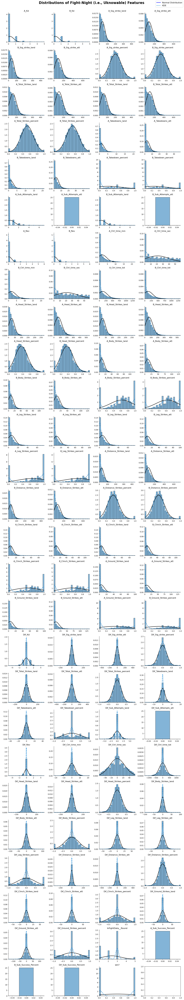

In [55]:
plot_feature_distributions(the_df)

### <a id='toc1_2_3_'></a>[C. Check Correlations with Target Variable](#toc0_)

In [56]:
def plot_correlations(dataframe):
    plot_df = dataframe.copy()
    # Select only numeric columns, excluding the 'win?' column
    numeric_columns = plot_df.select_dtypes(include=[np.number]).drop(columns=['win?'])

    # Ensure the 'win?' column exists in the DataFrame
    if 'win?' not in plot_df.columns:
        raise ValueError("Column 'win?' not found in the DataFrame.")

    # Calculate correlation coefficients for all columns and store them in a list along with column names
    correlation_list = []
    for column in numeric_columns.columns:
        x_data = plot_df[column].dropna()
        y_data = plot_df.loc[x_data.index, 'win?'].dropna()
        if len(np.unique(x_data)) < 2:
            continue
        correlation = np.corrcoef(x_data, y_data)[0, 1]
        correlation_list.append((column, correlation))

    # Sort the list by correlation value in descending order
    correlation_list.sort(key=lambda x: abs(x[1]), reverse=True)

    ncols = 4
    nrows = int(np.ceil(len(correlation_list) / ncols))

    # Adjust figure size
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows * 3))
    ax = ax.ravel()

    # Plot the charts in the sorted order
    for i, (column, correlation) in enumerate(correlation_list):
        x_data = plot_df[column]
        y_data = plot_df['win?']
        ax[i].scatter(x_data, y_data, alpha=0.6, color='#3182bd')

        # Calculate parameters of the regression line (slope and intercept)
        slope, intercept = np.polyfit(x_data, y_data, 1)
        # Create a polynomial function representing the regression line
        regression_line = np.poly1d([slope, intercept])

        # Generate x values for the regression line
        x_regression = np.linspace(np.min(x_data), np.max(x_data), 100)
        # Generate y values for the regression line using the polynomial function
        y_regression = regression_line(x_regression)

        # Plot the regression line
        ax[i].plot(x_regression, y_regression, 'r-', linewidth=2, color='#e6550d')

        # Customize title, labels, and font sizes
        ax[i].set_title(f'{column} vs. win?\nCorrelation: {correlation:.4f}', fontsize=9, fontweight='bold')
        ax[i].set_xlabel(column, fontsize=10)
        ax[i].set_ylabel('win?', fontsize=10)
        ax[i].tick_params(axis='both', which='major', labelsize=8)
        ax[i].spines['top'].set_visible(False)
        ax[i].spines['right'].set_visible(False)

    # Adjust layout and spacing between subplots
    plt.tight_layout(pad=3.0)
    # add title
    plt.suptitle(f'Correlation of {category_title} columns with win', fontsize=16, fontweight='bold', y=1.0, verticalalignment='top')
    # add subtitle
    plt.figtext(0.5, 0.995, f'Sorted from most to least correlated. Correlation values are Pearson correlation coefficients', fontsize=12, ha='center', va='top')
    plt.subplots_adjust(top=.985)
    return plt.show()
        

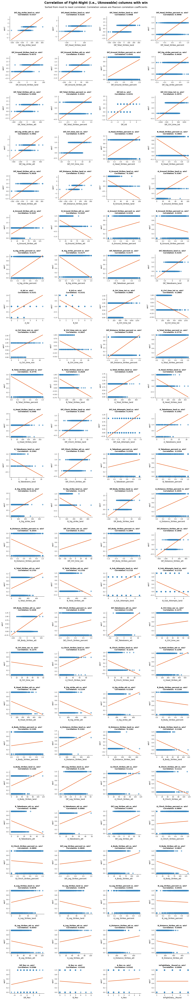

In [57]:
plot_correlations(the_df)

### <a id='toc1_3_'></a>[D. Boxplots](#toc0_)

In [58]:
def plot_boxplots(dataframe):
    plot_df = the_df

    # Select only numeric columns, excluding the 'win?' column
    numeric_columns = plot_df.select_dtypes(include=[np.number]).drop(columns=['win?'])

    # Ensure the 'win?' column exists in the DataFrame
    if 'win?' not in plot_df.columns:
        raise ValueError("Column 'win?' not found in the DataFrame.")

    ncols = 4
    nrows = int(np.ceil(len(numeric_columns.columns) / ncols))

    # Adjust figure size
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows * 3))
    ax = ax.ravel()

    # Plot the charts in the order of the columns
    for i, column in enumerate(numeric_columns.columns):
        x_data = plot_df[column]
        y_data = plot_df['win?']
        
        # Prepare the data for the box plot
        box_plot_data = pd.concat([x_data, y_data], axis=1)
        
        # Plot the grouped box plot
        sns.boxplot(x='win?', y=column, data=box_plot_data, ax=ax[i])
        
        # Customize title, labels, and font sizes
        ax[i].set_title(f'{column}', fontsize=12)
        ax[i].set_xlabel('win?', fontsize=10)
        ax[i].set_ylabel(column, fontsize=10)
        ax[i].tick_params(axis='both', which='major', labelsize=8)
        ax[i].spines['top'].set_visible(False)
        ax[i].spines['right'].set_visible(False)

    # Adjust layout and spacing between subplots
    plt.tight_layout(pad=3.0)
    # add title
    plt.suptitle(f'Boxplots of {category_title} features by win/loss', fontsize=16, fontweight='bold', y=1.0, verticalalignment='top')
    # add subtitle
    plt.subplots_adjust(top=.985)
    return plt.show()


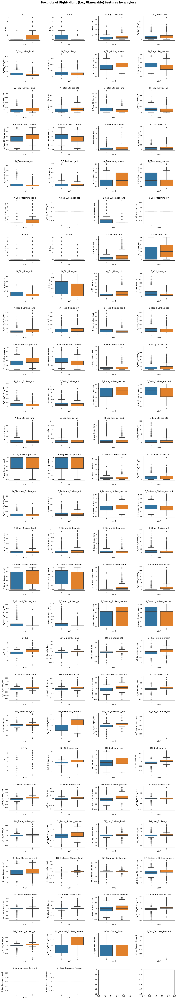

In [59]:
plot_boxplots(the_df)

In [60]:
def plot_correlations(dataframe):
    # Select only numeric columns, excluding the 'win?' column
    numeric_columns = infight_metrics_df.select_dtypes(include=[np.number]).drop(columns=['win?'])

    # Calculate the correlation coefficients between each numeric column and the 'win?' column
    correlations = numeric_columns.corrwith(infight_metrics_df['win?']).sort_values()
    # drop nans
    correlations.dropna(inplace=True)

    # Plot the correlation coefficients as a vertical bar plot
    plt.figure(figsize=(10, 20))  # Adjust figure size as needed
    sns.barplot(x=correlations.values, y=correlations.index, palette='coolwarm', orient='h')
    plt.title('Correlation with Fighter_A Victory')
    plt.xlabel('Correlation Coefficient')
    plt.xlim(-1, 1)  # Set x-axis limits to show full range of correlation coefficients
    plt.tight_layout()
    return plt.show()


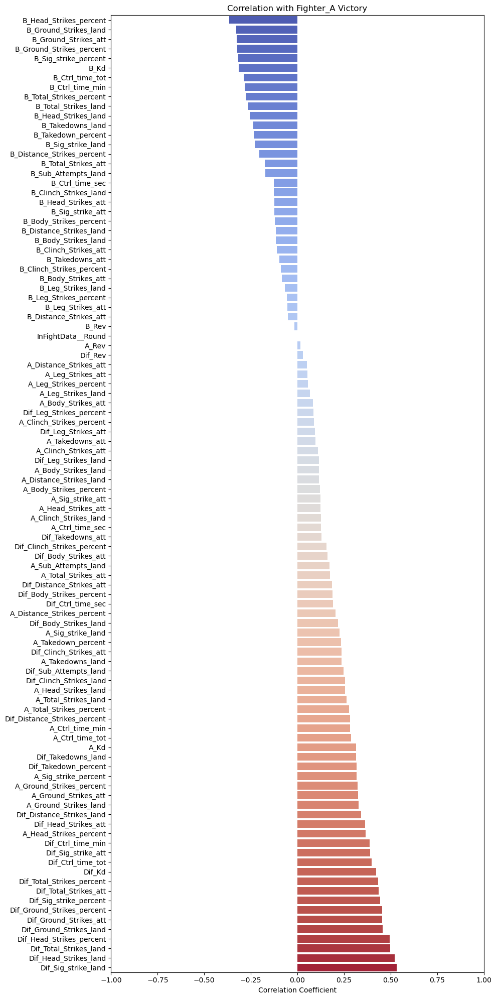

In [61]:
plot_correlations(the_df)

## <a id='toc1_3_'></a>[Category 2: Rolling Metrics](#toc0_)
Rolling metrics are career average metrics at the time of the fight. These are some of the most important columns in the dataset.

### <a id='toc1_3_1_'></a>[A. Check for Missing Values](#toc0_)

In [62]:
# Set Variables for EDA
the_df = df[all_rolling_metrics]
the_df['win?'] = df['win?']
category_title = 'Rolling Metrics'

In [63]:
check_missing_values(the_df)

No missing values in the DataFrame.


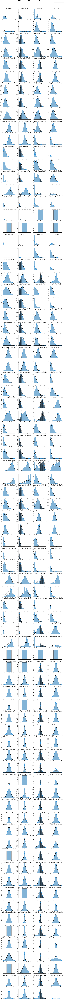

In [64]:
plot_feature_distributions(the_df)

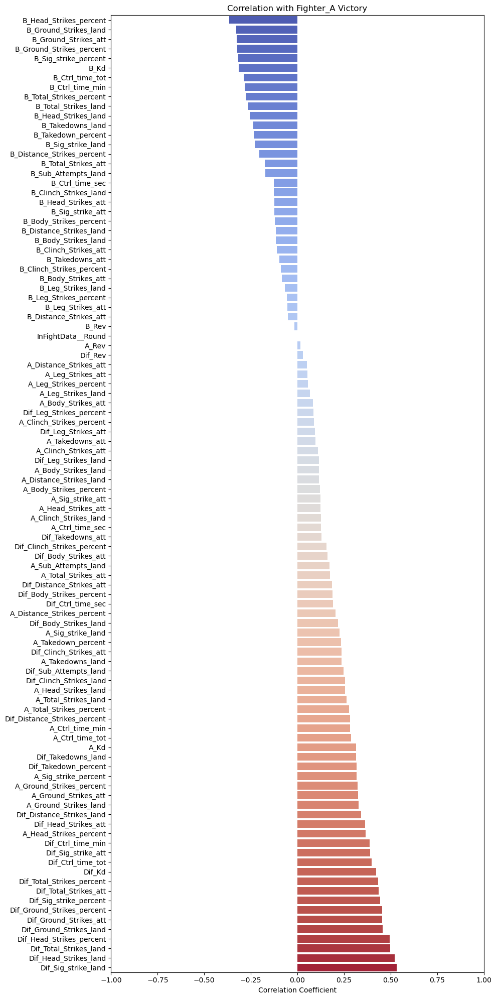

In [65]:
plot_correlations(the_df)

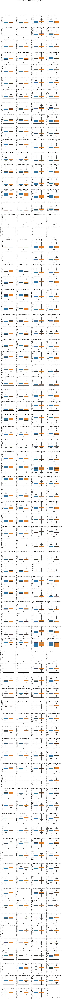

In [66]:
plot_boxplots(the_df)

#### <a id='toc1_3_4_1_'></a>[Correlation Matrix](#toc0_)

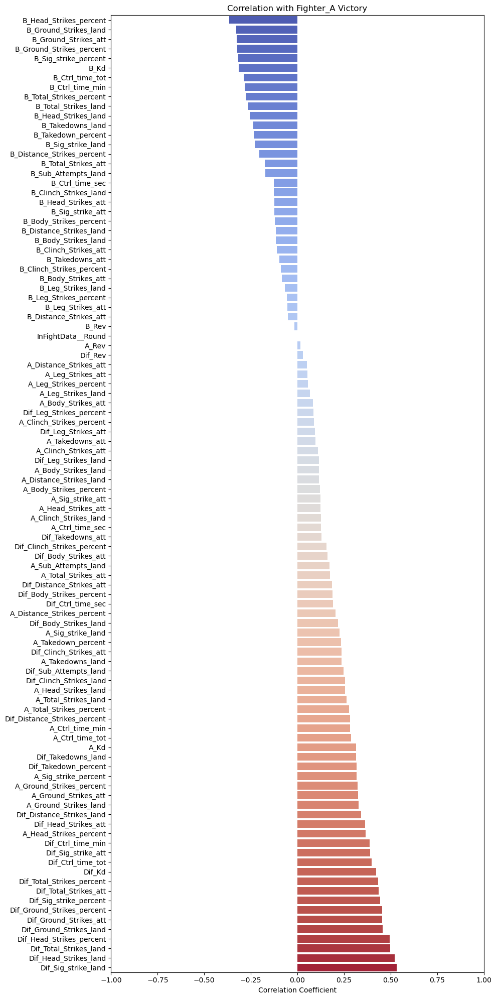

In [67]:
# correlation matrix
plot_correlations(the_df)

## <a id='toc1_4_'></a>[Category 3: Defensive Metrics (Previous Opponents)](#toc0_)

### <a id='toc1_4_1_'></a>[A. Check for Missing Values](#toc0_)

In [68]:
the_df = fighter_previous_opponent_metrics_df
the_df['win?'] = df['win?']
category_title = 'Rolling D'

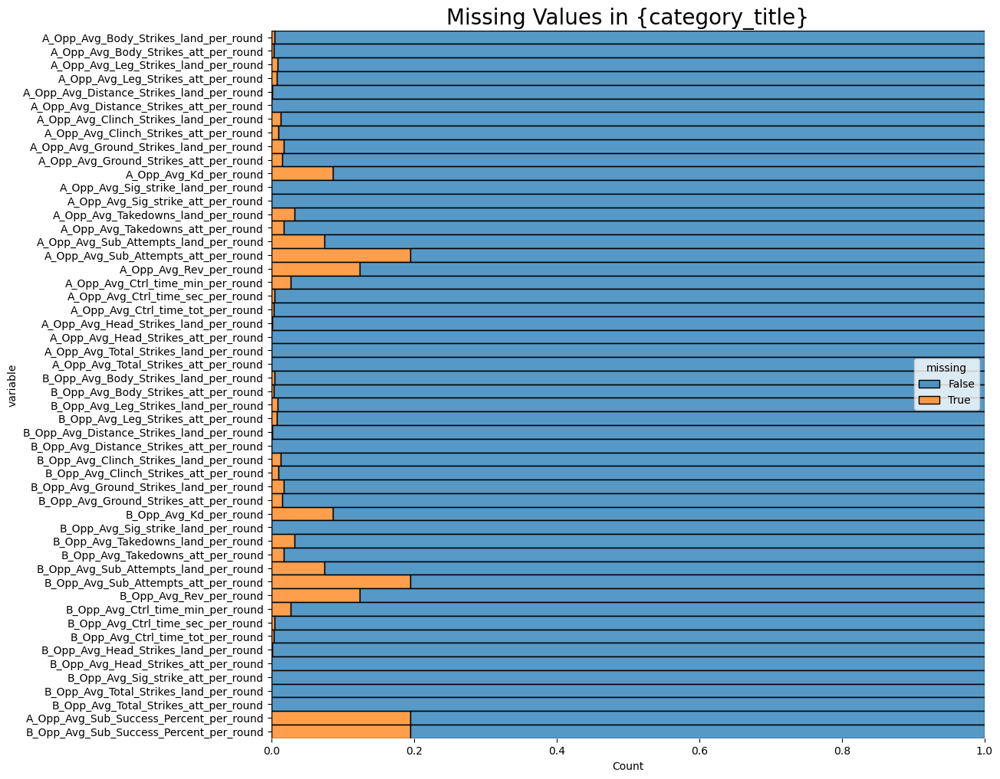

In [69]:
check_missing_values(the_df)

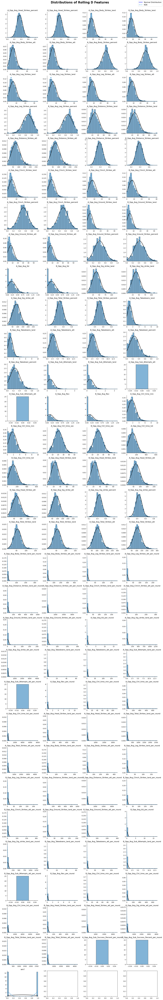

In [70]:
plot_feature_distributions(the_df)

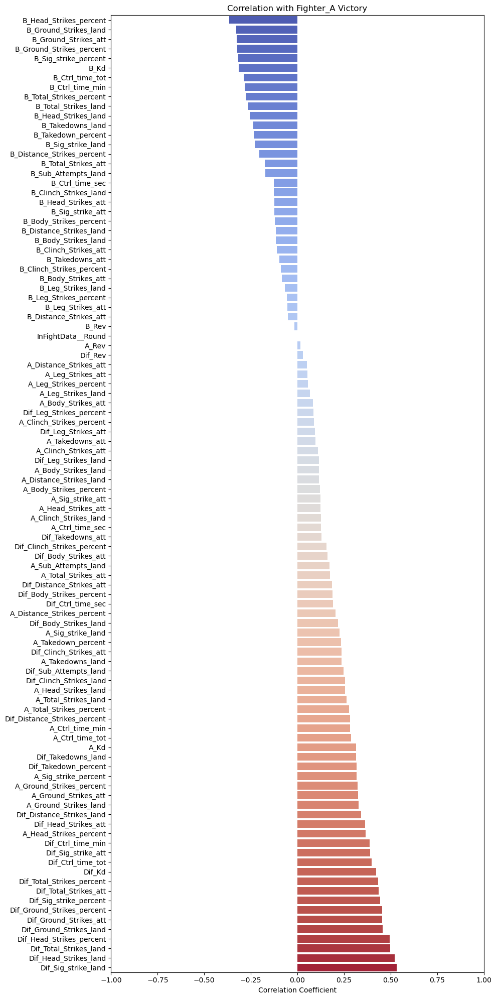

In [71]:
plot_correlations(the_df)

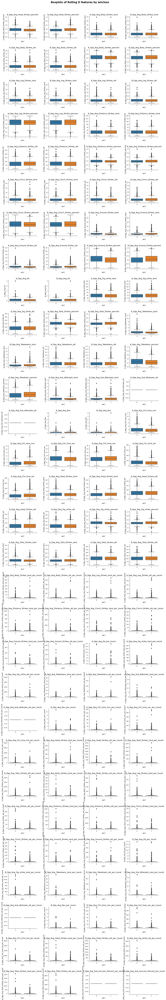

In [72]:
plot_boxplots(the_df)

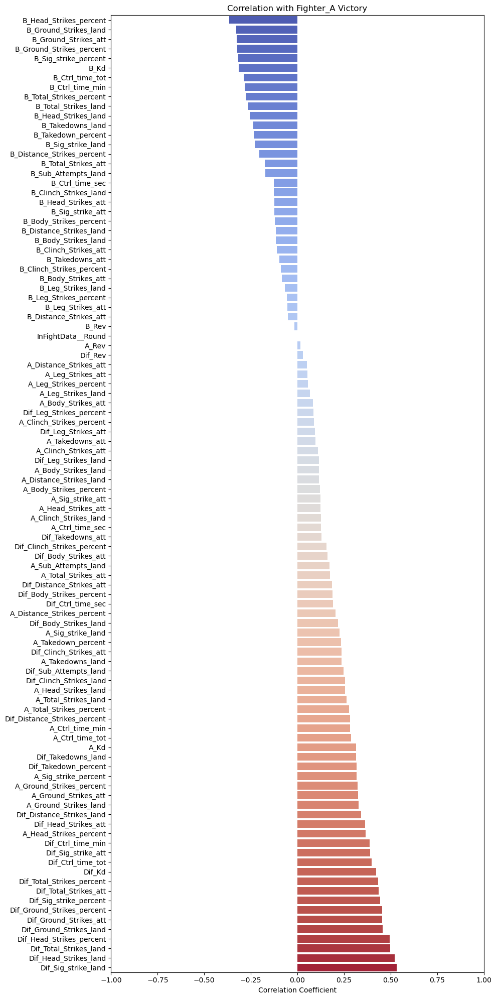

In [73]:
plot_correlations(the_df)

## <a id='toc1_4_2_'></a>[Category 4: General Metrics ](#toc0_)

In [74]:
the_df = fighter_previous_opponent_metrics_df
the_df['win?'] = df['win?']
category_title = 'General Metrics'

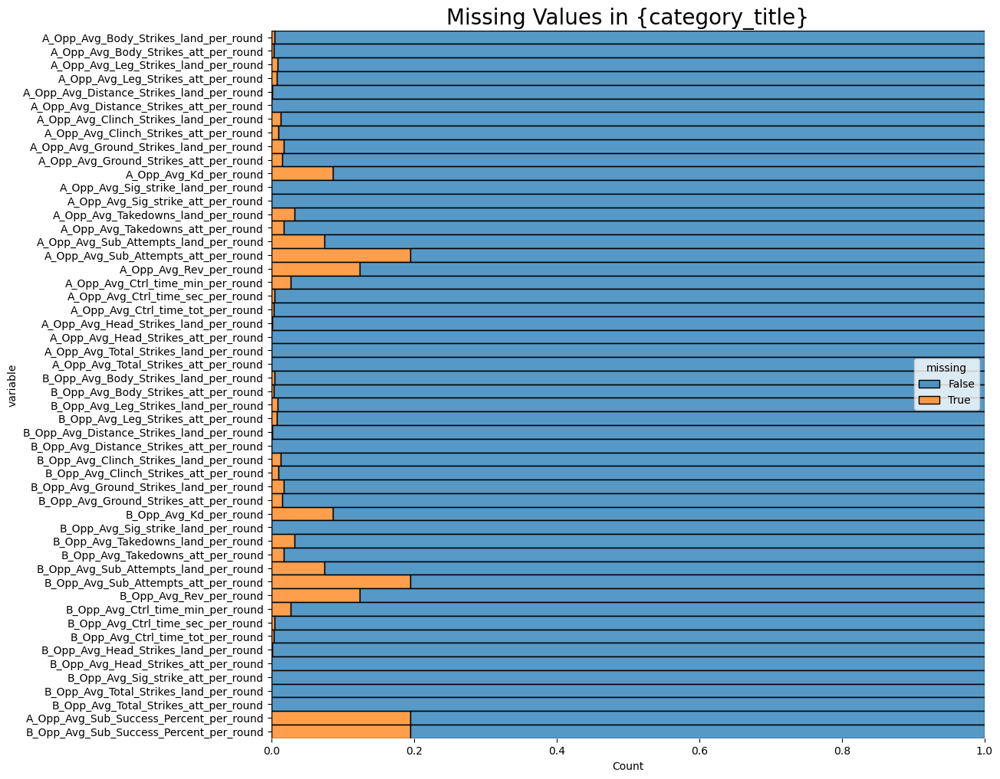

In [75]:
check_missing_values(the_df)

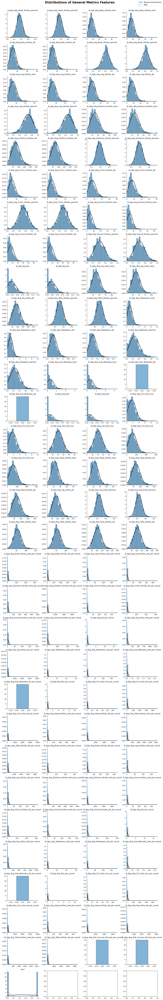

In [76]:
plot_feature_distributions(the_df)

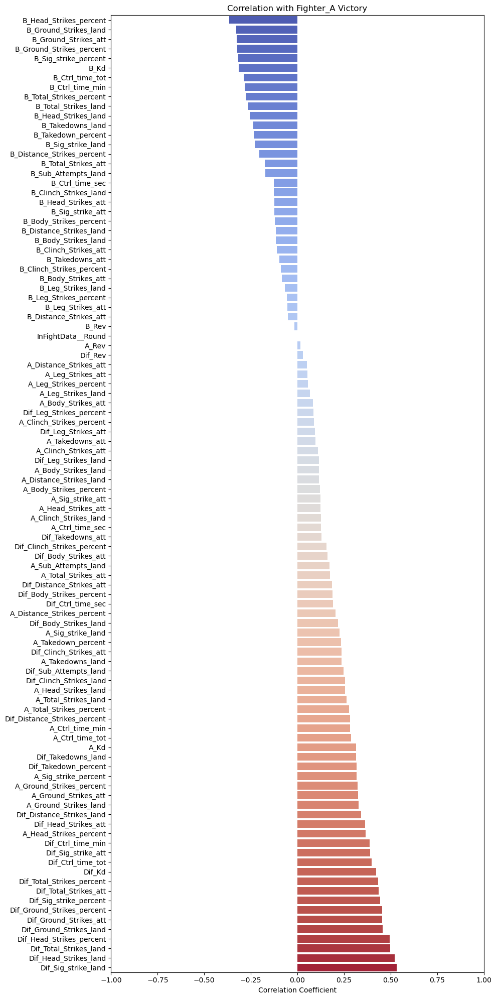

In [77]:
plot_correlations(the_df)

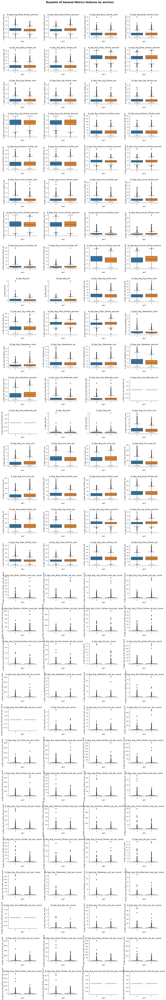

In [78]:
plot_boxplots(the_df)

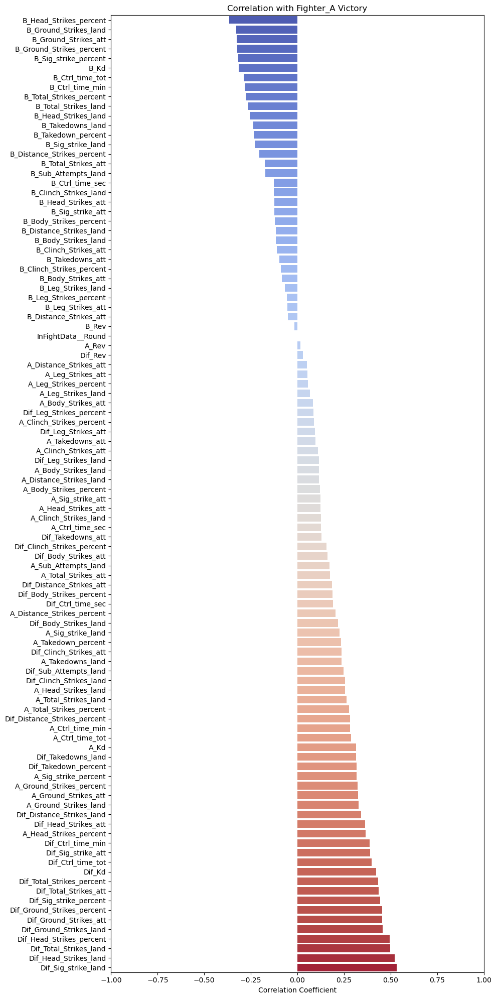

In [79]:
plot_correlations(the_df)

## <a id='toc1_5_'></a>[Category 5: Topdown Metrics](#toc0_)

In [80]:
the_df = topdown_metrics_df
the_df['win?'] = df['win?']
category_title = 'Topdown Metrics'

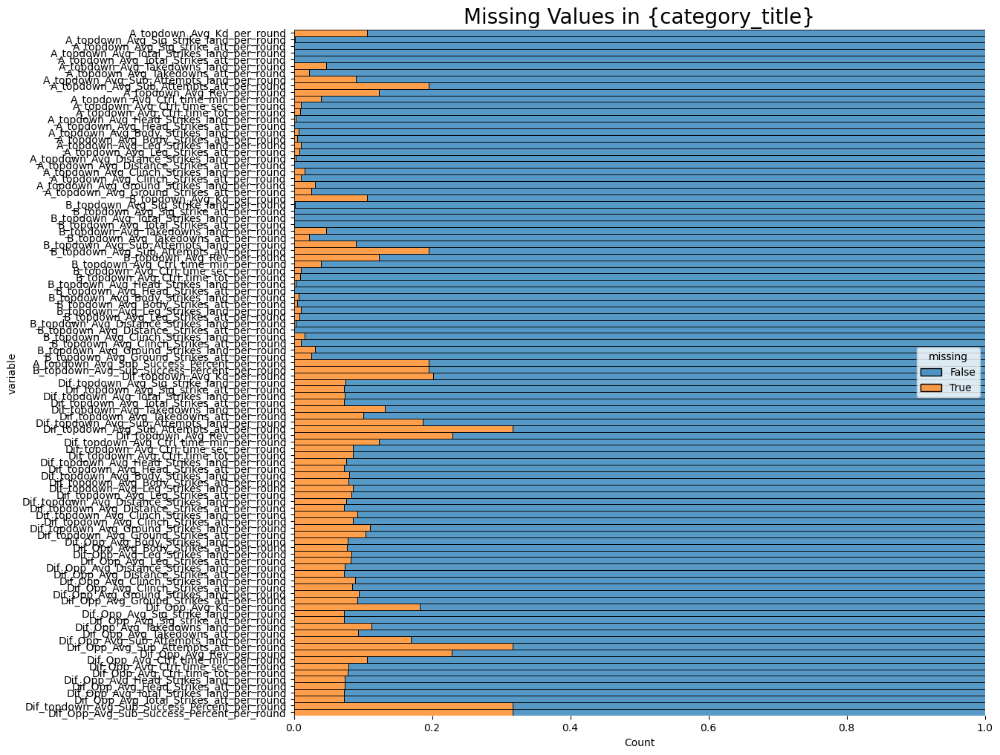

In [81]:
check_missing_values(the_df)

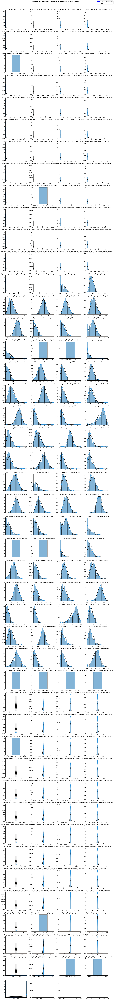

In [82]:
plot_feature_distributions(the_df)

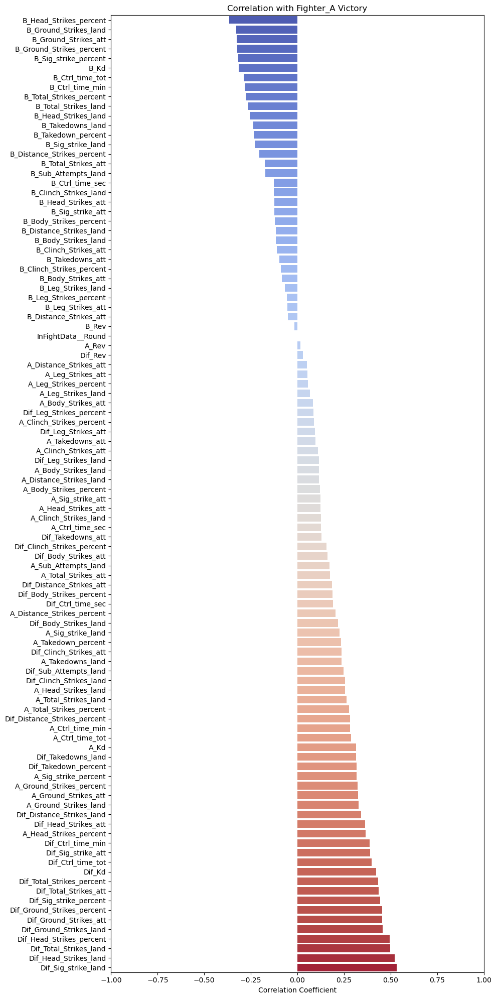

In [83]:
plot_correlations(the_df)

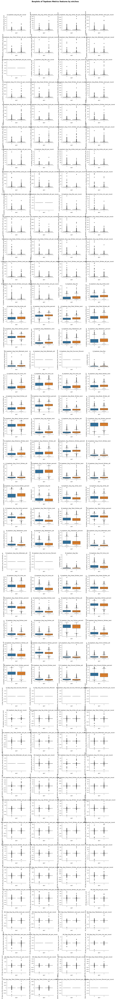

In [84]:
plot_boxplots(the_df)

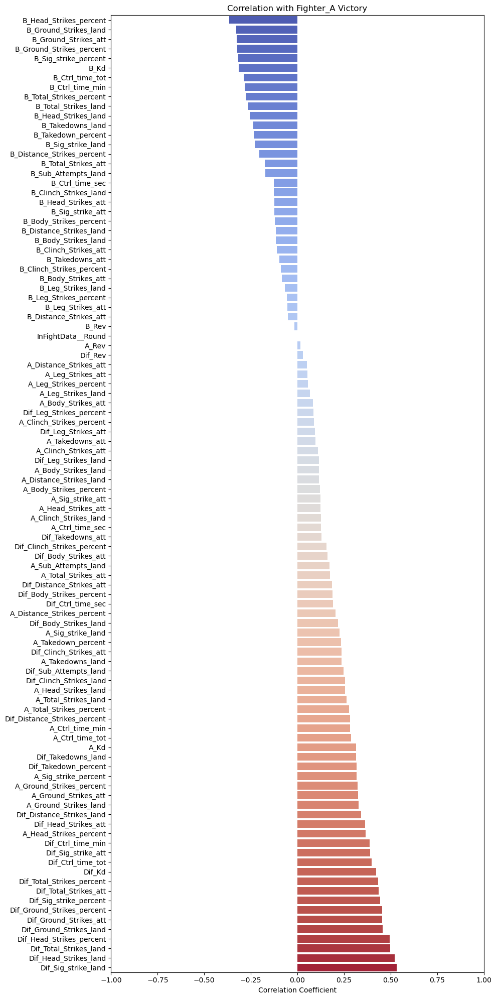

In [85]:
plot_correlations(the_df)

## <a id='toc1_6_'></a>[Category 6: Fighter Histories](#toc0_)

In [86]:
the_df = fighter_history_df
the_df['win?'] = df['win?']
category_title = 'Fighter History'

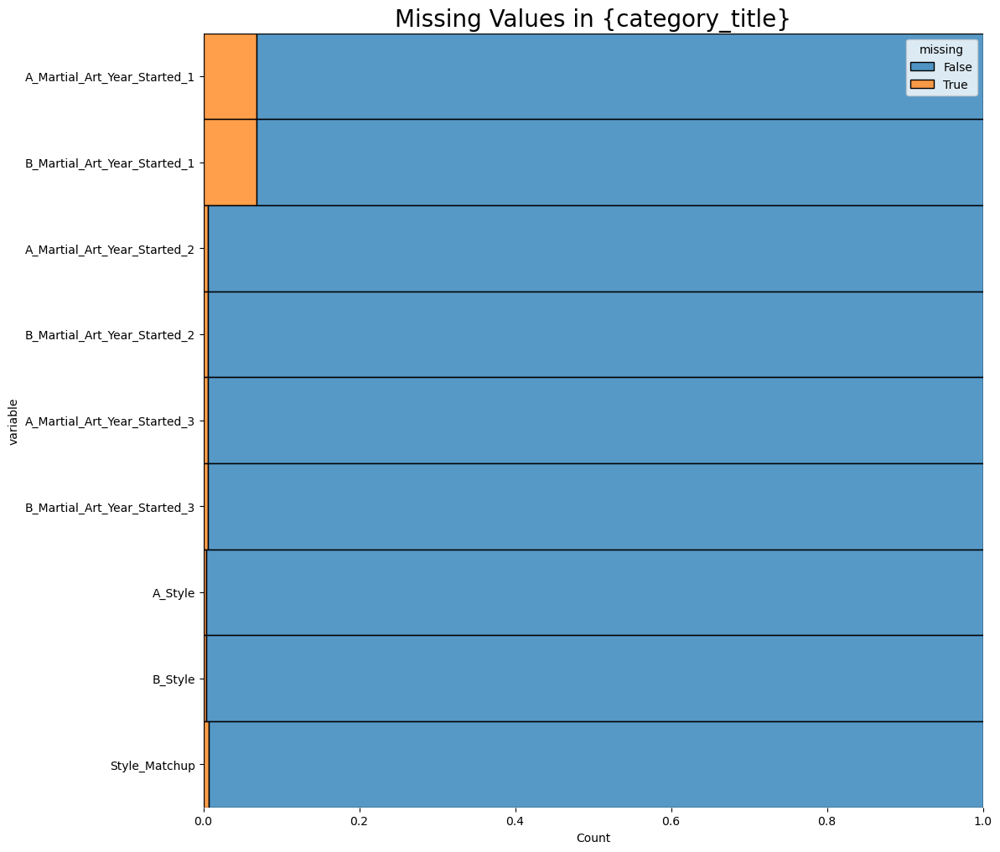

In [87]:
check_missing_values(the_df)

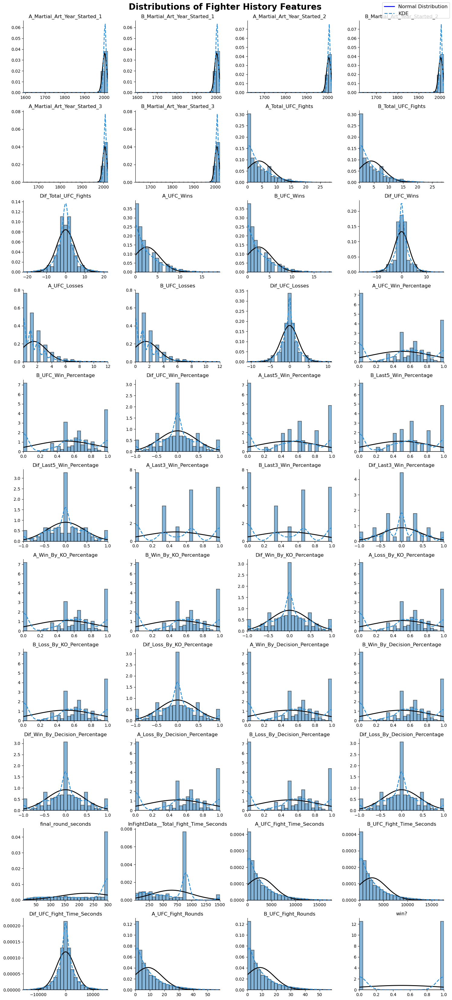

In [88]:
plot_feature_distributions(the_df)

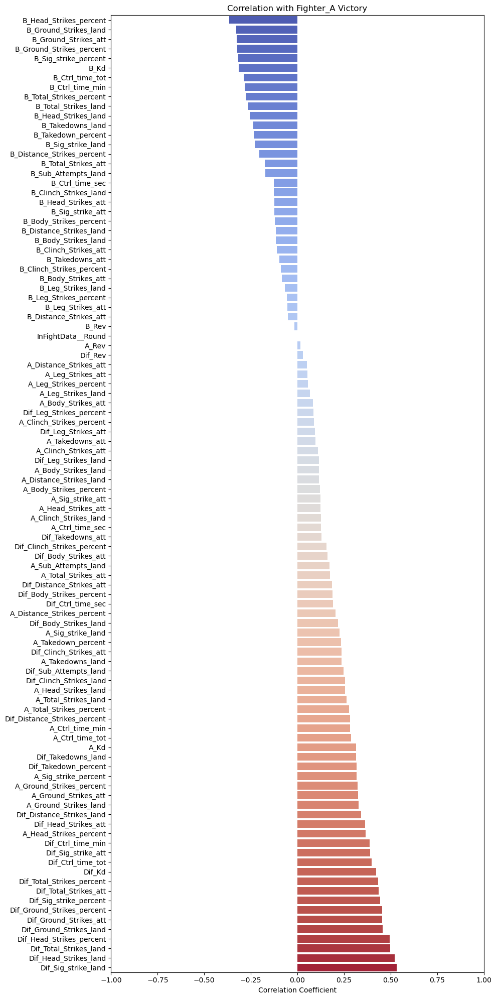

In [89]:
plot_correlations(the_df)

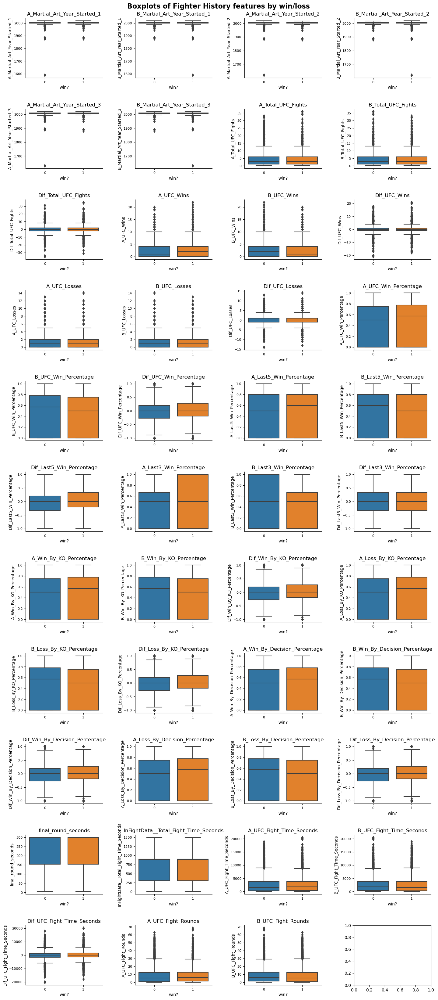

In [90]:
plot_boxplots(the_df)

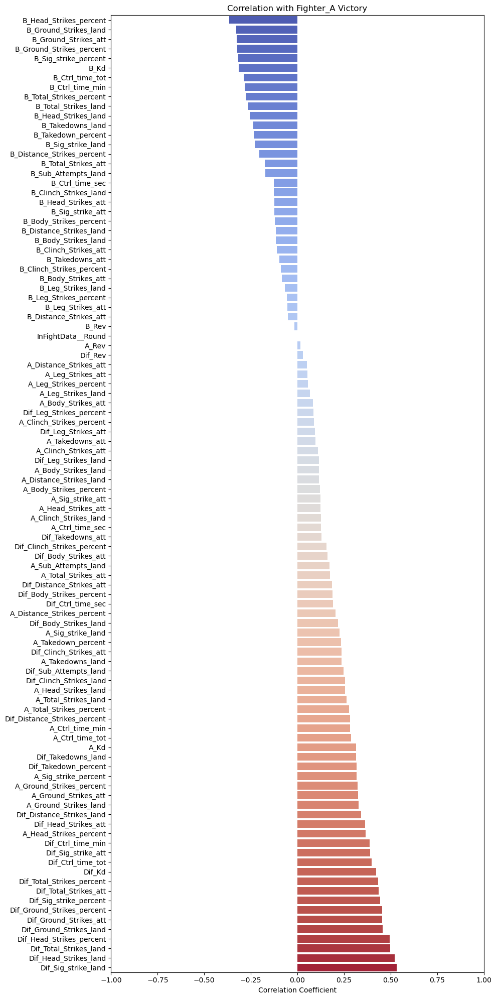

In [91]:
plot_correlations(the_df)